# post processing of ripples

This script attemps to remove false-positive ripples caused by chewing and head-bumps.

A lot of high frequency events may actually be muscle artifacts. These false positives will usually show up on all channels of distant electrodes. Conducting a current source density is one of the best ways to rule out false positives, but is not practical with tetrode arrays and bundles. Another way to rule out false positives is to filter out events that coincide with high emg activity. If emg recordings were not taken, one can estimate emg by finding the mean pairwise correlation of all channels over a sliding window. However, this method should be used where channels are at a good distance apart from each other (not tetrode bundles). 

A lot of the below items could have been implemented in the initial search for ripples (detect_swr_with_ripple_detection).

The basic structure of this notebook involves first filtering out extreme data that is not likely to be generated in the brain, then using a intracranial emg filter, and finally doing a manual check in neuroscope. 


In [1]:
# data managment and math functions
import pandas as pd
import numpy as np
import math

# plotting
from matplotlib import pyplot as plt

import neuroseries as nts

from scipy import stats

# for loading files
import h5py
import sys,os
import glob
import pickle

# Continuous Wavelet Transform
import obspy
from obspy.imaging.cm import obspy_sequential
from obspy.signal.tf_misfit import cwt

In [2]:
plt.style.use('dark_background')

params = {'legend.fontsize': 'large',
         'axes.labelsize': 'large',
         'axes.titlesize':'large',
         'xtick.labelsize':'large',
         'ytick.labelsize':'large'}
plt.rcParams.update(params)

plt.rcParams.update({'font.size': 13})
%config InlineBackend.figure_format = 'retina'

In [3]:
def get_session_path(session):
    f = h5py.File(session,'r')
    return f['session_path'][()].tobytes()[::2].decode()

def loadXML(path):
    """
    path should be the folder session containing the XML file
    Function returns :
        1. the number of channels
        2. the sampling frequency of the dat file or the eeg file depending of what is present in the folder
            eeg file first if both are present or both are absent
        3. the mappings shanks to channels as a dict
    Args:
        path : string
    Returns:
        int, int, dict
    """
    if not os.path.exists(path):
        print("The path "+path+" doesn't exist; Exiting ...")
        sys.exit()
    listdir = os.listdir(path)
    xmlfiles = [f for f in listdir if f.endswith('.xml')]
    if not len(xmlfiles):
        print("Folder contains no xml files; Exiting ...")
        sys.exit()
    new_path = os.path.join(path, xmlfiles[0])

    from xml.dom import minidom
    xmldoc = minidom.parse(new_path)
    nChannels = xmldoc.getElementsByTagName('acquisitionSystem')[0].getElementsByTagName('nChannels')[0].firstChild.data
    fs_dat = xmldoc.getElementsByTagName('acquisitionSystem')[0].getElementsByTagName('samplingRate')[0].firstChild.data
    fs = xmldoc.getElementsByTagName('fieldPotentials')[0].getElementsByTagName('lfpSamplingRate')[0].firstChild.data

    shank_to_channel = {}
    groups = xmldoc.getElementsByTagName('anatomicalDescription')[0].getElementsByTagName('channelGroups')[0].getElementsByTagName('group')
    for i in range(len(groups)):
        shank_to_channel[i] = np.sort([int(child.firstChild.data) for child in groups[i].getElementsByTagName('channel')])
    return int(nChannels), int(fs), shank_to_channel

def normalize(list, range):
    l = np.array(list) 
    a = np.max(l)
    c = np.min(l)
    b = range[1]
    d = range[0]
    m = (b - d) / (a - c)
    pslope = (m * (l - c)) + d
    return pslope

def get_scalogram(sig,fs,padding=100,f_min=150,f_max=250,fig=1,ax=0):
    
    # sample difference
    dt = 1/fs
    # pad signal
    sig_padded = np.pad(sig, (padding, padding), 'linear_ramp')
    # get time stamps
    t = np.linspace(0, dt * len(sig), len(sig))
    # get scalogram
    scalogram = cwt(sig_padded, dt, 8, f_min, f_max)
    # delete padding
    scalogram = np.delete(scalogram, np.s_[1:padding+1], axis=1) 
    scalogram = np.delete(scalogram, np.s_[-(padding+1):-1], axis=1) 
    
    # plot figure
    if fig==1:
        if ax == 0:
            fig = plt.figure()
            ax = fig.add_subplot(111)

        x, y = np.meshgrid(
            t,
            np.logspace(np.log10(f_min), np.log10(f_max), scalogram.shape[0]))

        ax.pcolormesh(x, y, np.abs(scalogram), cmap=obspy_sequential,shading='auto')
        ax.plot(t,normalize(sig,[f_min,f_max]),'k',linewidth=1)
        ax.set_ylabel("Frequency [Hz]")
        ax.set_ylim(f_min, f_max)
        # ax.set_yscale('log')
        if ax == 0:
            plt.show()
    
    return np.abs(scalogram)

In [4]:
save_path = "F:\\Projects\\PAE_PlaceCell\\swr_data\\"
sessions = glob.glob(save_path + '*.pkl')
ripple_maps = []

df=pd.DataFrame()
for session in sessions:
    with open(session, 'rb') as f:
        ripple_times = pickle.load(f)
        ripple_map = pickle.load(f)
    ripple_maps.append(ripple_map["ripple_map"])
    
    # add data frame of ripple features and add session id
    base = os.path.basename(session)
    ripple_times['session'] = os.path.splitext(base)[0]
    df = df.append(ripple_times,ignore_index=True)

ripple_maps = np.vstack(ripple_maps)     

def check_for_saved_file(save_path):
    files = glob.glob(save_path +'classified'+'/*.pkl')
    latest_file = max(files, key=os.path.getctime)
    print('reading... '+latest_file)
    df = pd.read_pickle(latest_file)
    return df

df = check_for_saved_file(save_path)
df

reading... F:\Projects\PAE_PlaceCell\swr_data\classified\swr_df_08_29_21.pkl


,start_time,end_time,ripple_duration,peak_channel,peak_amplitude,peak_freq,session,classification,classified,range
0,67.5472,67.6368,0.0896,3.0,722.301792,180.012548,LE2813_S20170920115122,0,1,5536.0
1,104.2456,104.3496,0.1040,4.0,672.901662,238.574525,LE2813_S20170920115122,1,1,2368.0
2,215.2024,215.3496,0.1472,1.0,5958.794132,142.732740,LE2813_S20170920115122,0,1,35581.0
3,302.9792,303.0992,0.1200,4.0,2803.005328,180.547277,LE2813_S20170920115122,0,1,21648.0
4,309.5952,309.6744,0.0792,1.0,555.847002,183.428506,LE2813_S20170920115122,0,1,5438.0
...,...,...,...,...,...,...,...,...,...,...
57574,526.3392,526.4648,0.1256,3.0,247.555298,243.367807,RH16_S20161207130642,0,0,3310.0
57575,539.3456,539.4048,0.0592,0.0,158.007427,167.179523,RH16_S20161207130642,0,0,936.0
57576,543.7880,543.8256,0.0376,3.0,153.679329,197.917565,RH16_S20161207130642,0,0,4541.0
57577,545.8168,545.8912,0.0744,0.0,172.187552,173.225576,RH16_S20161207130642,0,0,30009.0


## Get hpc sessions

In [5]:
basepath = 'F:/Projects/PAE_PlaceCell/ProcessedData/'
df_sessions = pd.read_csv(r'D:\ryanh\github\harvey_et_al_2020\Rdata_pae_track_cylinder_all_cells.csv')
hpc_sessions = pd.unique(df_sessions.session)
hpc_sessions

# strip file extension
hpc_sessions=[os.path.splitext(name)[0] for name in hpc_sessions]

idx = [i for i,value in enumerate(df.session) if value in hpc_sessions]
df = df.iloc[idx]
ripple_maps = ripple_maps[idx]

df = df.reset_index()

df

,index,start_time,end_time,ripple_duration,peak_channel,peak_amplitude,peak_freq,session,classification,classified,range
0,555,66.2624,66.3792,0.1168,0.0,1183.247592,160.516492,LEM3116_S20180715121821,1,1,6599.0
1,556,134.5600,134.6448,0.0848,7.0,2472.826522,218.637911,LEM3116_S20180715121821,0,1,12940.0
2,557,134.7720,134.9048,0.1328,7.0,4266.406940,227.057485,LEM3116_S20180715121821,1,1,11505.0
3,558,166.2600,166.3344,0.0744,0.0,1175.246766,235.401826,LEM3116_S20180715121821,1,1,4224.0
4,559,211.2496,211.3264,0.0768,0.0,1394.493504,195.617362,LEM3116_S20180715121821,1,1,6693.0
...,...,...,...,...,...,...,...,...,...,...,...
38618,57515,778.7968,778.9200,0.1232,2.0,2564.258232,141.225681,RH16_S20161207130000,0,0,32643.0
38619,57516,784.5056,784.6432,0.1376,2.0,967.141111,139.888367,RH16_S20161207130000,0,0,6934.0
38620,57517,785.4872,785.5984,0.1112,2.0,2160.076039,147.468297,RH16_S20161207130000,0,0,23520.0
38621,57518,945.3616,945.4472,0.0856,2.0,1102.594493,170.925002,RH16_S20161207130000,0,0,5625.0


## Add features to help remove noise

In [6]:
def martix_range(x, axis=1):
    return np.max(x, axis=axis) - np.min(x, axis=axis)

def max_diff(x, axis=1):
    return np.max(np.diff(x,axis=1),axis=1)

def clipped(x, axis=1):
    x_diff = np.diff(x,axis=1)
    return np.sum(x_diff==0,axis=1) / x_diff.shape[1]

df['range'] = martix_range(ripple_maps)
df['max_diff'] = max_diff(ripple_maps)
df['clipped'] = clipped(ripple_maps)

## Only keep ripples that pass the following thresholds

In [7]:
range_percentile = np.percentile(df.range,90)
max_diff_percentile = np.percentile(df.max_diff,90)
peak_amplitude_percentile = np.percentile(df.peak_amplitude,90)
freq_lower_percentile = np.percentile(df.peak_freq,0.25)
freq_upper_percentile = np.percentile(df.peak_freq,99.75)

# remove ripples that have unreasonably large or small voltage range
idx = np.logical_and(df.range < range_percentile,
                     df.range > 0)
ripple_maps = ripple_maps[idx]
df = df[idx]

# remove ripples that have unreasonably large or no jumps in voltage
idx = np.logical_and(df.max_diff < max_diff_percentile,
                     df.max_diff > 0)
ripple_maps = ripple_maps[idx]
df = df[idx]

# remove ripples that have unreasonably large or small amplitude
idx = np.logical_and(df.peak_amplitude < peak_amplitude_percentile,
                     df.peak_amplitude > 0)
ripple_maps = ripple_maps[idx]
df = df[idx]

# remove ripples that have very low or high frequency
idx = np.logical_and(df.peak_freq < freq_upper_percentile,
                     df.peak_freq > freq_lower_percentile)
ripple_maps = ripple_maps[idx]
df = df[idx]

# remove ripples that are > 0.2 clipped 
idx = df.clipped < 0.2
ripple_maps = ripple_maps[idx]
df = df[idx]

df = df.reset_index()

## filter ripples by EMG

In [8]:
emg_folder = 'F:/Projects/PAE_PlaceCell/EMG_from_LFP/'

max_emg = []
for ripple in df.itertuples():
    f = h5py.File(emg_folder + ripple.session + '_emg.mat','r')
    emg = f['data'][0]
    emg_ts = f['timestamps'][0]

    idx = np.logical_and(emg_ts >= ripple.start_time, emg_ts <= ripple.end_time)
    max_emg.append(np.max(emg[idx]))
    
df['max_emg'] = np.array(max_emg)    

#### find sessions that had good tetrode spacing 

(hyper-drive arrays instead of bundles)

bundles will have 8 "shanks"

In [9]:
basepath = 'F:/Projects/PAE_PlaceCell/ProcessedData/'
shank_number = []
for session in df.session:
    # get data session path from mat file
    path = get_session_path(basepath+session+'.mat')
    # load xml which has channel & fs info
    channels,fs,shank = loadXML(path)

    shank_number.append(len(shank))  
    
df['num_of_shanks'] = np.array(shank_number)

Specifically, lets keep ripples that have an emg of less than 0.85 for rats with electrode arrays. 

In [10]:
idx = (df.max_emg < 0.85) | (df.num_of_shanks < 9)
ripple_maps = ripple_maps[idx]
df = df[idx]

In [11]:
df

,level_0,index,start_time,end_time,ripple_duration,peak_channel,peak_amplitude,peak_freq,session,classification,classified,range,max_diff,clipped,max_emg,num_of_shanks
0,92,647,26.5048,26.6376,0.1328,0.0,427.088479,236.060848,LEM3116_S20180716174306,1,1,2537.0,941.0,0.000000,0.478615,8
1,104,659,209.5568,209.6456,0.0888,7.0,518.634784,221.545526,LEM3116_S20180716174306,1,1,5567.0,1335.0,0.000000,0.790860,8
2,145,700,696.5176,696.5760,0.0584,7.0,408.850930,167.774109,LEM3116_S20180716174306,1,1,3156.0,1435.0,0.000000,0.988645,8
3,149,704,716.3400,716.3912,0.0512,7.0,443.597782,180.213903,LEM3116_S20180716174306,0,1,3093.0,1485.0,0.013333,0.719452,8
4,158,713,1174.5808,1174.6600,0.0792,4.0,398.302836,159.521761,LEM3116_S20180716174306,1,1,1660.0,629.0,0.006667,0.525864,8
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
31408,38598,57494,320.8456,320.9240,0.0784,4.0,216.191112,191.971213,RH16_S20161126145021,0,0,2242.0,581.0,0.000000,0.185078,8
31409,38599,57495,323.7144,323.7824,0.0680,7.0,131.898327,188.687076,RH16_S20161126145021,0,0,2871.0,311.0,0.006667,0.246998,8
31410,38601,57497,27.7824,27.8336,0.0512,7.0,191.812084,164.097710,RH16_S20161126150318,0,0,2461.0,213.0,0.006667,0.233824,8
31411,38602,57498,70.7024,70.7680,0.0656,6.0,344.409875,142.250577,RH16_S20161126150318,0,0,6487.0,1039.0,0.000000,0.239151,8


## visualize some ripples

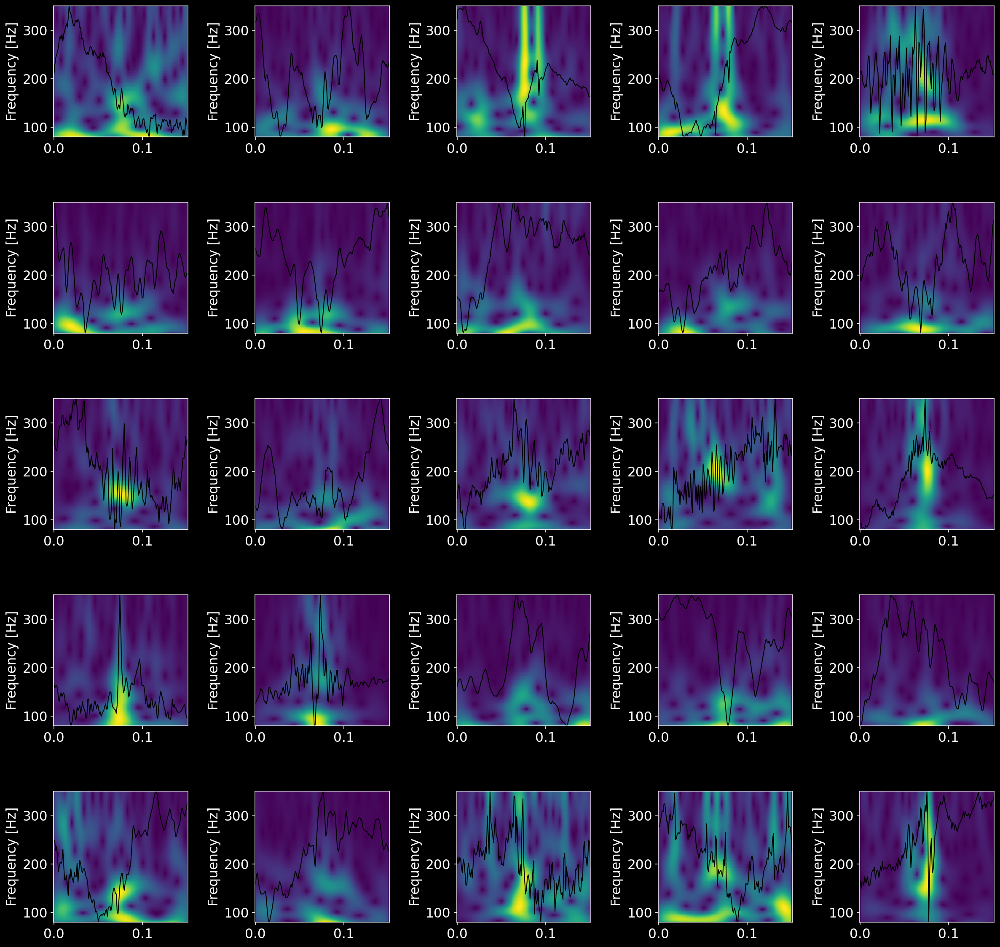

In [139]:

r = np.random.randint(0,len(ripple_maps),25)

fig, axs = plt.subplots(5,5, figsize=(20, 20), edgecolor='k')
fig.subplots_adjust(hspace = 0.5, wspace=0.5)
axs = axs.ravel()

for i in range(25):
    get_scalogram(ripple_maps[r[i],:],1000,f_min=80,f_max=350,ax=axs[i])


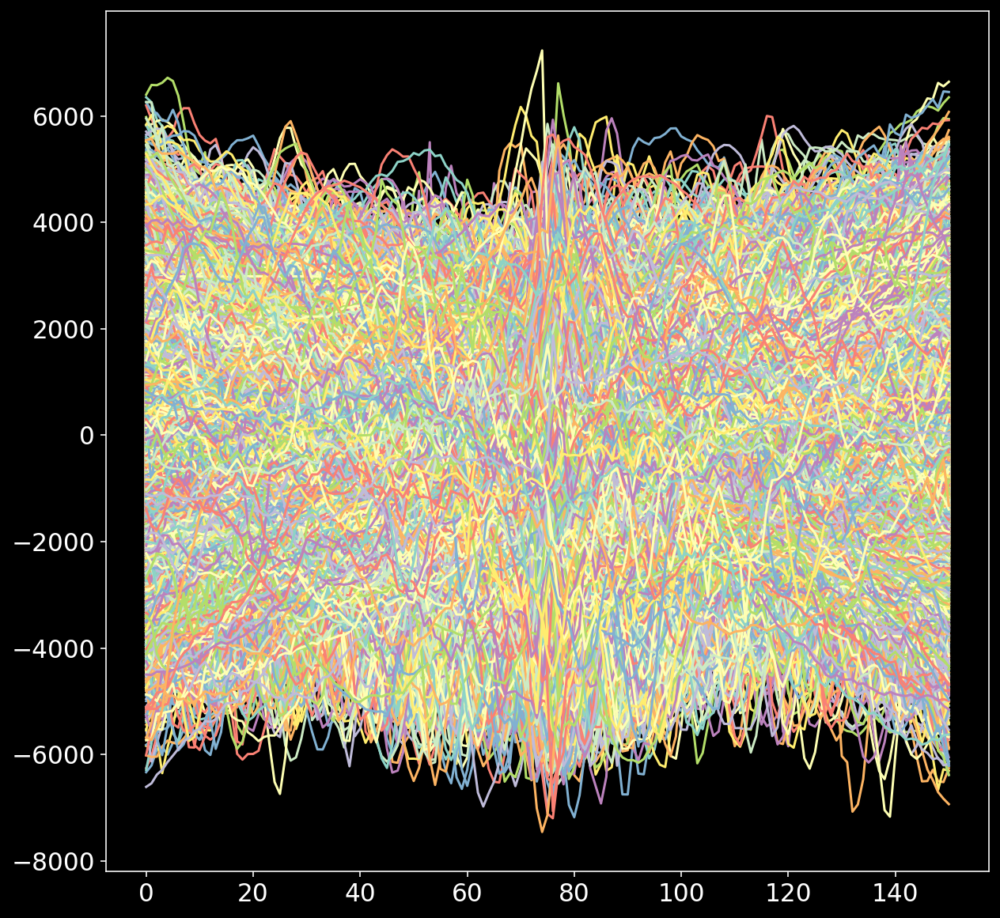

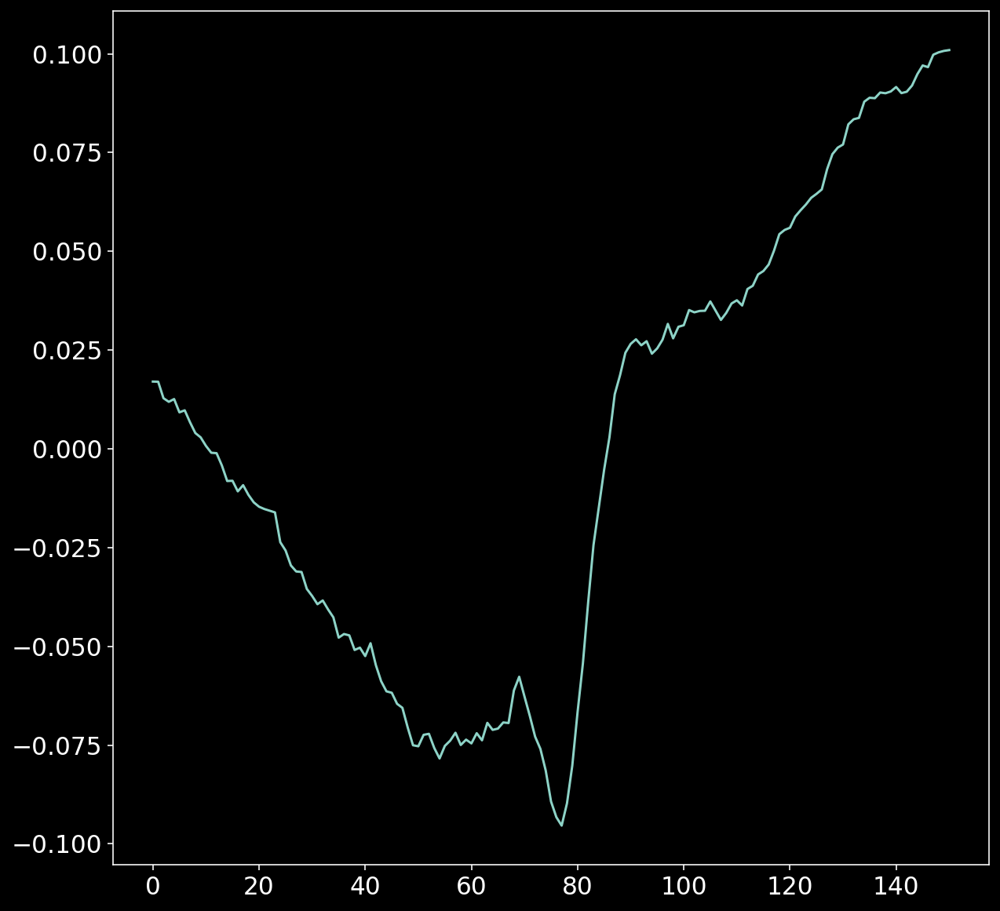

In [11]:
plt.figure(figsize=(10,10))
plt.plot(ripple_maps.T - np.mean(ripple_maps,axis=1))
plt.show()

plt.figure(figsize=(10,10))
plt.plot(np.mean(stats.zscore(ripple_maps,axis=1),axis=0))
plt.show()

## write neuroscope files

In [115]:
import neuroseries as nts

def make_Epochs(start, end):
    #Function to make an nts.IntervalSet dataframe with starting and ending epochs
    #Firstly, check whether both the lists are of same size or not
    if not (len(start) == len(end)):
        print("Start and End array lists are not of same dimension. Epochs IntervalSet can't be developed.")
        sys.exit()
    else:
        nts_array = []
        for i in range(len(start)):
            nts_array.append(nts.IntervalSet(start[i], end[i]))
        print(nts_array)
        return nts_array
    
def writeNeuroscopeEvents(path, ep, name):
    f = open(path, 'w')
    for i in range(len(ep)):
        f.writelines(str(ep.as_units('ms').iloc[i]['start']) + " "+name+" start "+ str(1)+"\n")
        #f.writelines(str(ep.as_units('ms').iloc[i]['peak']) + " "+name+" start "+ str(1)+"\n")
        f.writelines(str(ep.as_units('ms').iloc[i]['end']) + " "+name+" end "+ str(1)+"\n")
    f.close()
    return

def write_all_ripples(overwrite_data=0):
    if overwrite_data==1:
        print('warning, you may write over data')

        data_path = 'F:\\Projects\\PAE_PlaceCell\\ProcessedData\\'

        for session in pd.unique(df.session):
            idx = df.session == session

            start_time = nts.TsdFrame(df.start_time[idx], time_units = 's')
            end_time = nts.TsdFrame(df.end_time[idx], time_units = 's')

            rpt_ep = nts.IntervalSet(np.array(df.start_time[idx]), np.array(df.end_time[idx]),time_units = 's')

            path = get_session_path(data_path+session+'.mat')
            print(path)
            writeNeuroscopeEvents(path + "\Swr_Ripple.evt.rip", rpt_ep, "SWR Ripple event")

## uncommenting and running the following cell will write all the ripple event files

Take care not to save over your work after you manually remove ripples in neuroscope

In [ ]:
# write_all_ripples(overwrite_data=1)

### Helper function to get hours minutes seconds if an error occurs when reading ripple events

In [12]:
def convert_time(millis):
    millis = int(millis)
    seconds=(millis/1000)%60
    seconds = int(seconds)
    minutes=(millis/(1000*60))%60
    minutes = int(minutes)
    hours=(millis/(1000*60*60))%24

    print ("%d:%d:%d" % (hours, minutes, seconds))

## Read curated ripples back in

In [65]:
data_path = 'F:\\Projects\\PAE_PlaceCell\\data\\'

files = glob.glob(data_path+'/**/*Swr_Ripple.evt.rip',recursive=True)
start = []
end = []
for file in files:
    f = open(file, 'r')
    for i,line in enumerate(f):
#         print(i,repr(line))
        if 'start' in line:
            if  (i % 2) == 0:
                start.append(np.float64(line.split('SWR')[0]))
            else:
                print(file)
                print(i,repr(line))
                print(i, 'is not even!')
                print(np.float64(line.split('SWR')[0]))
                convert_time(np.float64(line.split('SWR')[0]))
                break
        elif 'end' in line:
            end.append(np.float64(line.split('SWR')[0]))
start = np.array(start) / 1000
end = np.array(end) / 1000  

In [66]:
print(start.shape)
print(end.shape)

(26881,)
(26881,)


## recreate dataframe of selected ripples

In [67]:
thres = 1e-5
df_keep = []
ripple_maps_keep = []
for i in range(len(start)):
    # Laura helped :) 
    idx = (abs(df.start_time - start[i]) < thres) & (abs(df.end_time - end[i]) < thres)
#     print(sum(idx))
    df_keep.append(df[idx])
    ripple_maps_keep.append(ripple_maps[idx]) 

ripple_maps_keep = np.vstack(ripple_maps_keep)
df_keep_test = pd.concat(df_keep)
df_keep_test # hmmm cutes ;) 

,level_0,index,start_time,end_time,ripple_duration,peak_channel,peak_amplitude,peak_freq,session,classification,classified,range,max_diff,clipped,max_emg,num_of_shanks
0,92,647,26.5048,26.6376,0.1328,0.0,427.088479,236.060848,LEM3116_S20180716174306,1,1,2537.0,941.0,0.000000,0.478615,8
1,104,659,209.5568,209.6456,0.0888,7.0,518.634784,221.545526,LEM3116_S20180716174306,1,1,5567.0,1335.0,0.000000,0.790860,8
4,158,713,1174.5808,1174.6600,0.0792,4.0,398.302836,159.521761,LEM3116_S20180716174306,1,1,1660.0,629.0,0.006667,0.525864,8
5,161,716,1348.0672,1348.1464,0.0792,7.0,677.584263,239.129378,LEM3116_S20180716174306,1,1,2900.0,2115.0,0.000000,0.784750,8
6,169,724,1552.0496,1552.1656,0.1160,7.0,481.594118,241.230488,LEM3116_S20180716174306,1,1,2976.0,1580.0,0.000000,0.544334,8
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
31407,38597,57493,287.2416,287.3512,0.1096,1.0,475.327760,196.330154,RH16_S20161126145021,0,0,3033.0,1156.0,0.006667,0.240804,8
31408,38598,57494,320.8456,320.9240,0.0784,4.0,216.191112,191.971213,RH16_S20161126145021,0,0,2242.0,581.0,0.000000,0.185078,8
31409,38599,57495,323.7144,323.7824,0.0680,7.0,131.898327,188.687076,RH16_S20161126145021,0,0,2871.0,311.0,0.006667,0.246998,8
31410,38601,57497,27.7824,27.8336,0.0512,7.0,191.812084,164.097710,RH16_S20161126150318,0,0,2461.0,213.0,0.006667,0.233824,8


## n ripples per session

In [47]:
pd.options.display.max_rows = None
df_keep_test.session.value_counts()
# pd.options.display.max_rows = 15

LEM3216_S20190805141510    1378
LEM3246_S20190629164240     956
LEM3246_S20190701153855     890
LEM3216_S20190718101925     733
LEM3216_S20190720145517     701
LEM3216_S20190731112719     696
LEM3216_S20190814123043     691
LEM3216_S20190808141648     606
LEM3206_S20190724151552     598
LEM3216_S20190813135257     549
LEM3216_S20190821125550     539
LEM3116_S20180717110938     531
LEM3216_S20190814172812     524
LEM3216_S20190807105102     457
LEM3216_S20190802094401     455
LEM3216_S20190809140023     455
LEM3216_S20190717174058     449
LEM3216_S20190812175606     441
LEM3216_S20190810172326     438
LEM3216_S20190808101926     397
LEM3206_S20190628174755     391
LEM3216_S20190801165651     373
LEM3206_S20190725155548     348
LEM3206_S20190717140525     339
LEM3246_S20190706150556     314
LEM3206_S20190722211425     313
LEM3246_S20190717115825     313
LEM3206_S20190720132154     308
LEM3206_S20190718172605     307
LEM3206_S20190702114353     303
LEM3246_S20190702103544     300
LEM3206_

In [58]:
pd.options.display.max_rows = 15

## visualize

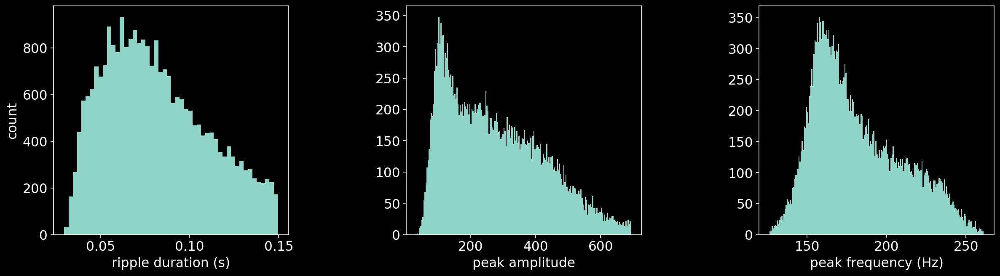

In [68]:
fig, axs = plt.subplots(1,3, figsize=(20, 5), edgecolor='k')
fig.subplots_adjust(hspace = 0.5, wspace=0.5)
axs = axs.ravel()

axs[0].hist(df_keep_test.ripple_duration,50)
axs[0].set_ylabel('count')
axs[0].set_xlabel('ripple duration (s)')

axs[1].hist(df_keep_test.peak_amplitude,200)
axs[1].set_xlabel('peak amplitude')

axs[2].hist(df_keep_test.peak_freq,200)
axs[2].set_xlabel('peak frequency (Hz)')

plt.show()

## plot all ripples for each session

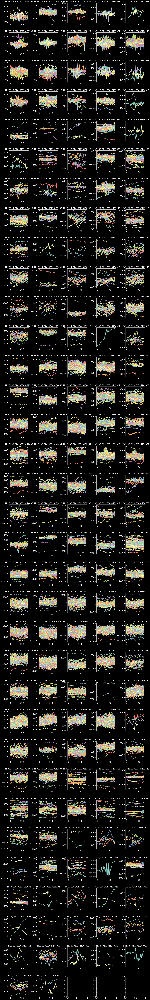

In [69]:
session_list = pd.unique(df_keep_test.session)
n_columns = 5
n_rows = math.ceil(len(session_list)/n_columns) 

fig, axs = plt.subplots(n_rows,n_columns, figsize=(20, 150), edgecolor='k')
fig.subplots_adjust(hspace = 0.5, wspace=0.5)
axs = axs.ravel()

for i,s in enumerate(session_list):
    idx = df_keep_test.session == s
    axs[i].plot(ripple_maps_keep[idx].T)
    axs[i].set_title(s)

## Mean ripples over sessions

In [ ]:
session_list = pd.unique(df_keep_test.session)
n_columns = 5
n_rows = math.ceil(len(session_list)/n_columns) 

fig, axs = plt.subplots(n_rows,n_columns, figsize=(20, 150), edgecolor='k')
fig.subplots_adjust(hspace = 0.5, wspace=0.5)
axs = axs.ravel()

for i,s in enumerate(session_list):
    idx = df_keep_test.session == s
    axs[i].plot(np.mean(ripple_maps_keep[idx],axis=0))
    axs[i].set_title(s)